In [77]:
%load_ext autoreload
%autoreload 2
from alphatoe import models, plot, interpretability, game
import torch
from showmethetypes import SMTT
import umap
from sklearn.cluster import KMeans
from sklearn.preprocessing import StandardScaler
import numpy as np

The autoreload extension is already loaded. To reload it, use:
  %reload_ext autoreload


In [59]:
tt = SMTT()

In [60]:
autoenc = models.SparseAutoEncoder(512, 512).cuda()
autoenc.load_state_dict(
    torch.load(
        "../models/SAE_models/SAE_hidden_size-512_lamda-1e-07_epoch-600_batch_32768.pt"
    )
)

<All keys matched successfully>

In [61]:
second_autoenc = models.SparseAutoEncoder(512, 512).cuda()
second_autoenc.load_state_dict(
    torch.load(
        "../models/SAE_models/SAE_hidden_size-512_lamda-5e-08_epoch-600_batch_32768.pt"
    )
)

<All keys matched successfully>

In [62]:
model = interpretability.load_model(
    "../models/all_games_models/prob all 8 layer control-20230718-185339"
)

# Umap feature clustering 

In [63]:
print(autoenc.W_out.shape)

torch.Size([512, 512])


In [64]:
plot.imshow_div(autoenc.W_out @ autoenc.W_out.T)

In [65]:
plot.imshow_div(autoenc.W_out)

In [66]:
reducer = umap.UMAP(
    n_neighbors=20, n_components=2, metric="cosine", min_dist=0, random_state=1337
)

embedding_one = reducer.fit_transform(autoenc.W_out.detach().cpu())

/opt/miniconda3/lib/python3.10/site-packages/umap/umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



In [67]:
normalize_one = torch.nn.functional.normalize(autoenc.W_out)
normalize_two = torch.nn.functional.normalize(second_autoenc.W_out)

In [68]:
reducer = umap.UMAP(
    n_neighbors=20, n_components=2, metric="cosine", min_dist=0, random_state=1337
)

embedding_two = reducer.fit_transform(second_autoenc.W_out.detach().cpu())

/opt/miniconda3/lib/python3.10/site-packages/umap/umap_.py:1943: UserWarning:

n_jobs value -1 overridden to 1 by setting random_state. Use no seed for parallelism.



In [69]:
reducer = umap.UMAP(n_neighbors=20, n_components=2, metric="cosine", min_dist=0)

embedding = reducer.fit_transform(
    torch.cat([normalize_one, normalize_two]).detach().cpu()
)

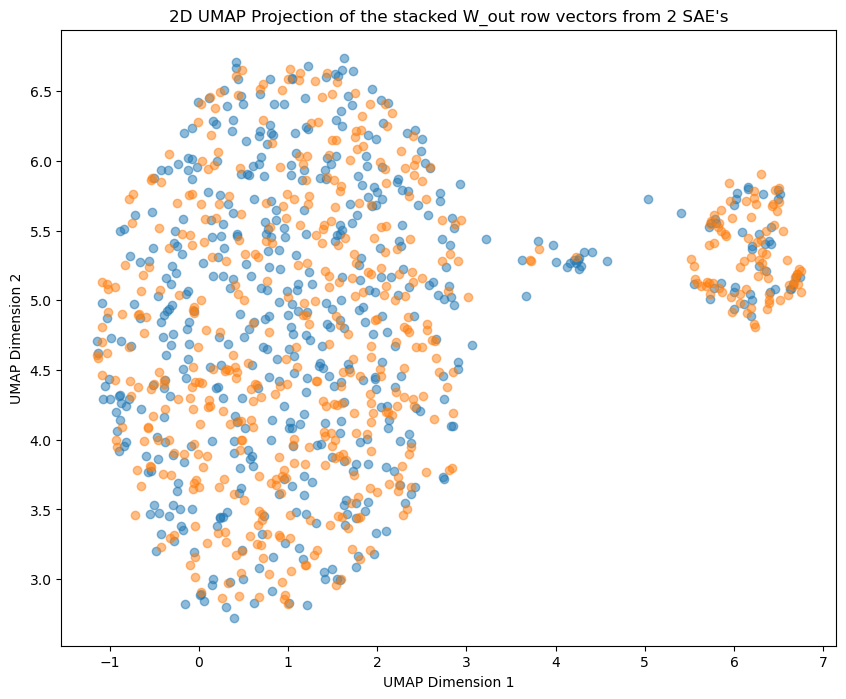

In [70]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 8))
plt.scatter(embedding[:512, 0], embedding[:512, 1], alpha=0.5)
plt.scatter(embedding[512:, 0], embedding[512:, 1], alpha=0.5)
plt.title("2D UMAP Projection of the stacked W_out row vectors from 2 SAE's")
plt.xlabel("UMAP Dimension 1")
plt.ylabel("UMAP Dimension 2")
plt.show()

# The fish structure emerges

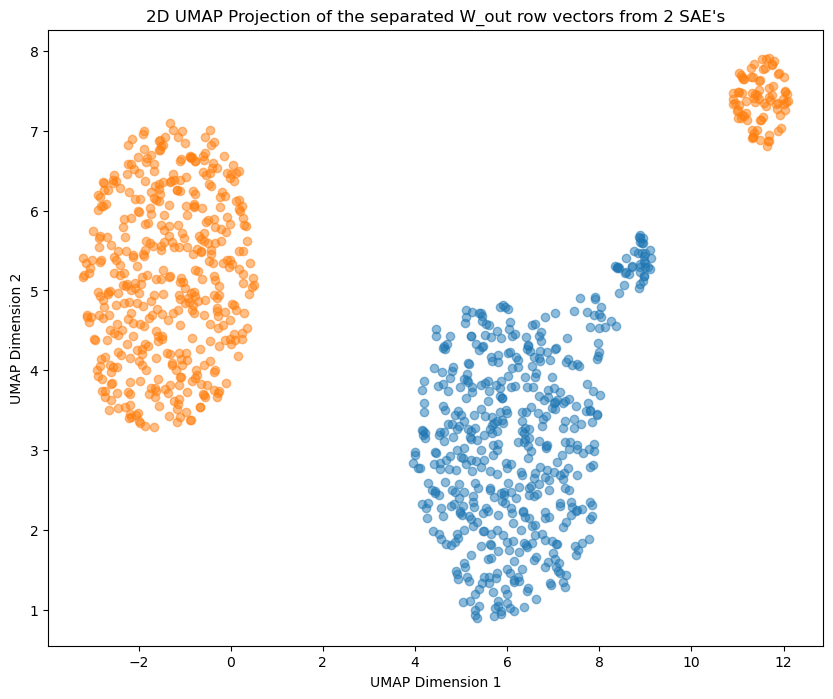

In [71]:
import matplotlib.pyplot as plt

plt.figure(figsize=(10, 8))
plt.scatter(embedding_one[:, 0], embedding_one[:, 1], alpha=0.5)
plt.scatter(embedding_two[:, 0], embedding_two[:, 1], alpha=0.5)
plt.title("2D UMAP Projection of the separated W_out row vectors from 2 SAE's")
plt.xlabel("UMAP Dimension 1")
plt.ylabel("UMAP Dimension 2")
plt.show()

In [72]:
plot.imshow_div(normalize_one.T @ normalize_two)

In [73]:
res = torch.nn.functional.normalize(autoenc.W_out) @ torch.nn.functional.normalize(
    second_autoenc.W_out.T
)
res[390, 430] = 0
plot.imshow_div(res)

In [74]:
k = 2
kmeans = KMeans(n_clusters=k, random_state=42)
clusters = kmeans.fit_predict(embedding)

/home/thetis/.local/lib/python3.10/site-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



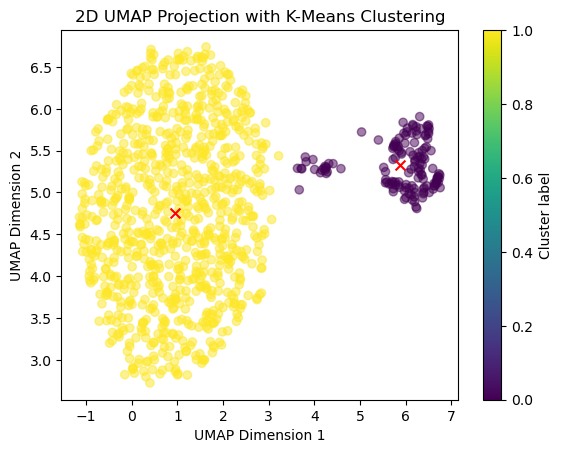

In [75]:
# Scatter plot of the embedding colored by cluster assignment
plt.scatter(embedding[:, 0], embedding[:, 1], alpha=0.5, c=clusters, cmap="viridis")

# Optionally, plot the cluster centers
cluster_centers = kmeans.cluster_centers_
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c="red", s=50, marker="x")

# Adding titles and labels
plt.title("2D UMAP Projection with K-Means Clustering")
plt.xlabel("UMAP Dimension 1")
plt.ylabel("UMAP Dimension 2")

# Adding a color bar
plt.colorbar(label="Cluster label")

plt.show()

In [80]:
num_one = normalize_one.shape[0]  # Number of rows in normalize_one

# Separate the cluster assignments
clusters_one = clusters[:num_one]
clusters_two = clusters[num_one:]

# Sort 'normalize_one' and 'normalize_two' based on the clusters
sorted_normalize_one = normalize_one[torch.argsort(torch.tensor(clusters_one))]
sorted_normalize_two = normalize_two[torch.argsort(torch.tensor(clusters_two))]

In [83]:
plot.imshow_div(sorted_normalize_one @ sorted_normalize_one.T)

In [81]:
plot.imshow_div(sorted_normalize_one @ sorted_normalize_two.T)